<center><h1> Political party comments LDA </h1></center>

# 1. Information

В данном ноутбуке проводиться LDA-анализ коментариев в группах VK, принадлежащих следующим политическим партиям:  
**Единая Россия**,    
**ЛПР**,   
**Справедливая Россия**,   
**КПРФ**,  
**ЛДПР**,  
**Навальный**,  
**Партия Роста**,  
**РотФронт**,  
**Союз Марксистов**,  
**Яблоко**,  
**Патриоты России**,  
**Гражданская Платформа**    
Использован код https://github.com/DmitrySerg/top-russian-music.

# 2. Fetching Data

## 2.1 Import packages

In [6]:
import warnings
warnings.filterwarnings('ignore')

from tika import parser
import re

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

plt.style.use("ggplot")
%matplotlib inline

import pickle
from tqdm import tqdm_notebook

In [7]:
prepare = False

## 2.2 Text Preprocess

In [11]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from string import punctuation
import pymorphy2
import time
from joblib import Parallel, delayed, parallel_backend

In [15]:
tokenizer = RegexpTokenizer('\w+|[^\w\s]+«»')
morph = pymorphy2.MorphAnalyzer()
stop_words = stopwords.words('russian')

def lemmize_text(morph, token):
    return morph.parse(token)[0].normal_form

#Preprocess function
def preprocess_text(text):
    data_tokenized=tokenizer.tokenize(text)
    tokens = [lemmize_text(morph, token) for token in data_tokenized]
    tokens = [token for token in tokens if token not in stop_words\
              and token != " " \
              and token.strip() not in punctuation]
    
    return tokens

In [16]:
def parce_prog(data, file_name, party_name, ideology):
    print('\r'+party_name)
    with open(file_name, 'rb') as f:
        data_comm = pickle.load(f)
    for i in tqdm_notebook(data_comm):
        data_lemmed = (preprocess_text(i['text']))
        data = data.append({'text': str(data_lemmed), 'party': party_name, 'ideology':ideology},ignore_index=True)
    return data

In [17]:
if prepare:
    df = pd.DataFrame(columns = ['text', 'party', 'ideology'])
    party_name = ['Единая Россия', 'ЛПР', 'Справедливая Россия', 'КПРФ', 'ЛДПР', 
                    'Навальный', 'Партия Роста', 'РотФронт', 'Союз Марксистов', 'Яблоко',
                                     'Патриоты России', 'Гражданская Платформа']
    
    vk_group_name = ['er_ru', 'lpr_vk', 'spravo_ross', 'kprf', 'ldpr', 
                     'teamnavalny', 'partrost', 'rot_front', 'marxist_union', 'yabloko_ru',
                     'rupatriots', 'civilplatform']
    ideology =  ['центризм консерватизм', 'либертарианство', 'левый центризм', 'левый центризм', 'либеральный консерватизм', 
                   'либеральный консерватизм', 'либеральный консерватизм', 'марксизм-ленинизм', 'марксизм-ленинизм', 'социальный либерализм',
                   'демократический социализм', 'консерватизм либерализм']
    
    
    for i in tqdm_notebook(range(len(vk_group_name))):
        file_name = '../data/politics_group_comments_{}'.format(vk_group_name[i])
        df = parce_prog(df, file_name, party_name[i], ideology[i])
    with open('../data/df_comments_final', 'wb') as f:
        pickle.dump(df,f)
else:
    with open('../data/df_comments', 'rb') as f:
        df = pickle.load(f)

In [18]:
df.shape

(2370360, 3)

In [19]:
df.party.value_counts()

КПРФ                     918578
Навальный                760877
ЛДПР                     282402
Единая Россия            122287
Яблоко                   106814
РотФронт                  78723
ЛПР                       34266
Партия Роста              27317
Справедливая Россия       25657
Союз Марксистов           11260
Гражданская Платформа      1606
Патриоты России             573
Name: party, dtype: int64

In [20]:
df

,text,party,ideology
0,['красавец'],Навальный,либеральный консерватизм
1,"['банкротство', 'ликвидация', 'чёт', 'думать',...",Навальный,либеральный консерватизм
2,"['подписаться', 'заново', 'сила', 'весь', 'рос...",Навальный,либеральный консерватизм
3,"['платёжный', 'система', 'мир', 'пахать', '4',...",Навальный,либеральный консерватизм
4,['сдаваться'],Навальный,либеральный консерватизм
...,...,...,...
2370355,"['собираться', 'вступить', '18', 'читать', 'за...",ЛДПР,либеральный консерватизм
2370356,"['заявление', 'рассматриваться', 'сразу', 'про...",ЛДПР,либеральный консерватизм
2370357,"['спасибо', 'вступить']",ЛДПР,либеральный консерватизм
2370358,"['хотеть', 'правда', 'пожалуйста', 'человек', ...",ЛДПР,либеральный консерватизм


In [21]:
df.loc[df['party']=='КПРФ'].tail(10)

,text,party,ideology
2087948,['труд'],КПРФ,левый центризм
2087949,"['это', 'хозяин', 'видно', 'молодец', 'батька']",КПРФ,левый центризм
2087950,"['вперёд', 'назад']",КПРФ,левый центризм
2087951,"['фронтовик', 'прикрывать', 'грех', 'партия', ...",КПРФ,левый центризм
2087952,"['еле', 'гео', 'ргий', 'бо', 'ннэр', '15', 'фе...",КПРФ,левый центризм
2087953,"['никита', 'мигалковы', 'вообще', 'должный', '...",КПРФ,левый центризм
2087954,"['весь', 'понятно', 'медвепуты', 'сговор', 'за...",КПРФ,левый центризм
2087955,"['интересный', 'статья']",КПРФ,левый центризм
2087956,"['пора', 'переосмыслить', 'понятие', 'социализ...",КПРФ,левый центризм
2087957,['йух'],КПРФ,левый центризм


## 2.4 Formation of the dictionary and corpus of texts

In [23]:
from ast import literal_eval
# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

In [24]:
if prepare:
    bag_of_words = df.text.apply(literal_eval)
    with open('bag_of_words.pkl', 'wb') as f:
        pickle.dump(bag_of_words, f)
else:
    with open('bag_of_words.pkl', 'rb') as f:
        bag_of_words = pickle.load( f)

In [25]:
bag_of_words

0                                                 [красавец]
1          [банкротство, ликвидация, чёт, думать, суд, её...
2          [подписаться, заново, сила, весь, россия, своб...
3          [платёжный, система, мир, пахать, 4, оформлять...
4                                                [сдаваться]
                                 ...                        
2370355    [собираться, вступить, 18, читать, заявление, ...
2370356    [заявление, рассматриваться, сразу, просто, бы...
2370357                                  [спасибо, вступить]
2370358    [хотеть, правда, пожалуйста, человек, родиться...
2370359                              [читать, знать, правда]
Name: text, Length: 2370360, dtype: object

In [26]:
if prepare:
    bag_of_words_np = bag_of_words.to_numpy()
    # Build the bigram and trigram models
    bigram = gensim.models.Phrases(bag_of_words_np, min_count=5, threshold=100) # higher threshold fewer phrases.
    # Faster way to get a sentence clubbed as a trigram/bigram
    bigram_mod = gensim.models.phrases.Phraser(bigram)
    trigram = gensim.models.Phrases(bigram_mod[bag_of_words_np], min_count=5, threshold=80) # higher threshold fewer phrases.
    # Faster way to get a sentence clubbed as a trigram/bigram
    trigram_mod = gensim.models.phrases.Phraser(trigram)
    trigram_mod.save('trigram_mod.pkl')
    
    data_words_bigrams = [trigram_mod[bigram_mod[w]] for w in bag_of_words_np]
    with open('bigrams.pkl', 'wb') as f:
        pickle.dump(data_words_bigrams, f)

else:
    trigram_mod = gensim.models.Phrases.load('trigram_mod.pkl')
    
    with open('bigrams.pkl', 'rb') as f:
        data_words_bigrams = pickle.load(f)

In [28]:
if prepare:
    data_words_bg = [np.array(i) for i in data_words_bigrams]
    data_words_bg = np.array(data_words_bg)
    id2word = corpora.Dictionary(data_words_bg)
    id2word.filter_extremes(no_below=3, no_above=0.4, keep_n=3*10**6)#0.3
    id2word.save('id2word.pkl')
else:
    id2word = corpora.Dictionary.load('id2word.pkl')

In [29]:
len(id2word.keys())

285862

In [30]:
if prepare:
    corpus = [id2word.doc2bow(text) for text in data_words_bg]
    with open('corpus.pkl', 'wb') as f:
        pickle.dump(corpus, f)
else:
    with open('corpus.pkl', 'rb') as f:
        corpus = pickle.load(f)

# 3. LDA learning

In [49]:
top_num =15

In [50]:
if prepare:
    lda_model = gensim.models.ldamodel.LdaModel(
    #lda_model =  gensim.models.LdaMulticore(
        corpus         =corpus  ,
        id2word        =id2word ,
        num_topics     =top_num , 
        random_state   =42      ,
        eval_every     =20      ,
        passes         =5       ,
        alpha          ='auto'  ,
        per_word_topics=True     )
    lda_model.save('lda_default_{}.pkl'.format(top_num))
else:
    lda_model = gensim.models.ldamodel.LdaModel.load('lda_default_{}.pkl'.format(top_num))

# 4. Results Visualization

In [51]:
# Пакет для построения облаков слов
from wordcloud import WordCloud 

## 4.1 Topics Visualization and interpretation

In [52]:
def plotWordCloud(topic_number, them_name=''):
    """
        Builds visualization of words based on topic texts
    """
    # get the frequencies and words of the topic
    text = dict(lda_topics[topic_number][1])
    
    # building a word cloud
    wordcloud = WordCloud(background_color="white", max_words=100, width=900, height=900, collocations=False)
    wordcloud = wordcloud.generate_from_frequencies(text)
    plt.figure(figsize=(15, 10))
    plt.title("Тема № {} {}".format(topic_number, them_name))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off");

In [36]:
#lda_topics = lda_model.show_topics(num_topics=top_num, num_words=100,formatted=False)
#for i in range(top_num):
#    plotWordCloud(topic_number=i)

In [37]:
themes30 = {
            0: "Даты"                   ,     10: "Голосование 1"        ,       20: "Желания"         ,   #30: "30",
            1: "Эпитеты"                ,     11: "Предлоги и междометия",       21: "Внешняя политика",   #31: "31",
            2: "Действия"               ,     12: "Проблемы и закон"     ,       22: "Путин и Украина" ,   #32: "32",
            3: "Голосование"            ,     13: "Государство"          ,       23: "Партия"          ,   #33: "33",
            4: "От рефлексии к действию",     14: "Вопросы к Навальному" ,       24: "мусорный топик 1",   #34: "34",
            5: "Голосование 0"          ,     15: "Жизнь 0"              ,       25: "ЛДПР"            ,   #35: "35",
            6: "мусорный топик 0"       ,     16: "Права"                ,       26: "мусорный топик 2",   #36: "36",
            7: "Что делать? 0"          ,     17: "Правительство"        ,       27: "Дело"            ,   #37: "37",
            8: "Про человека"           ,     18: "Жизнь 1"              ,       28: "Наша Страна"     ,   #38: "38",
            9: "Единая Россия"          ,     19: "Русское"              ,       29: "Народ и власть"      #39: "39"
}

In [38]:
themes15 = {
            0: "Президент"                ,     
            1: "Работа и жизнь"           ,     
            2: "Украина"                  ,     
            3: "ЛДПР"                     ,     
            4: "Армия"                    ,     
            5: "Русский"                  ,
            6: "Гражданин и государство"  ,     
            7: "Дружба"                   ,     
            8: "Человек"                  ,     
            9: "Страна и что с ней делать",     
           10: "Голосование"              ,
           11: "Украина и Крым"           ,
           12: "Америка"                  ,
           13: "Числа"                    ,
           14: "Общение"          
          }

**Visualization for 30 topics**

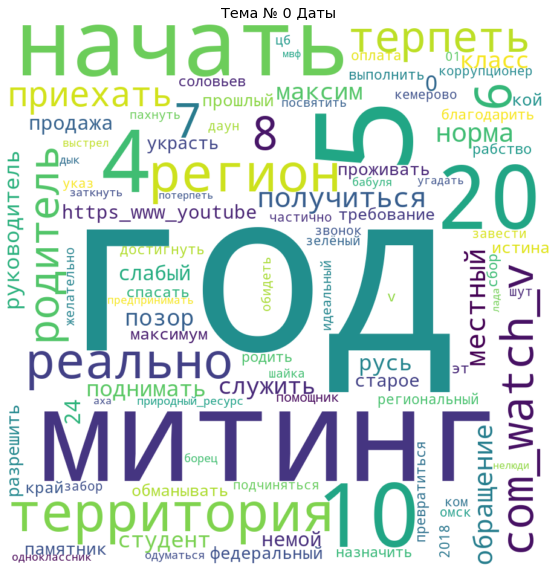

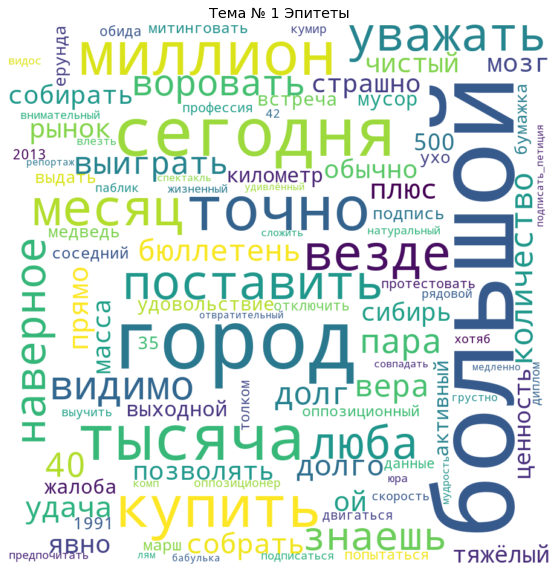

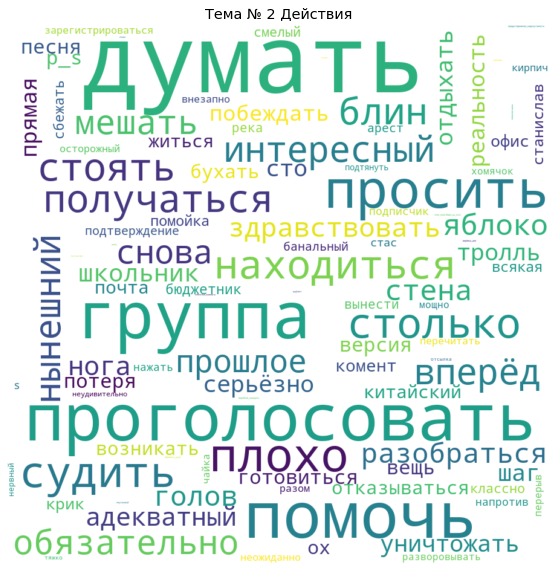

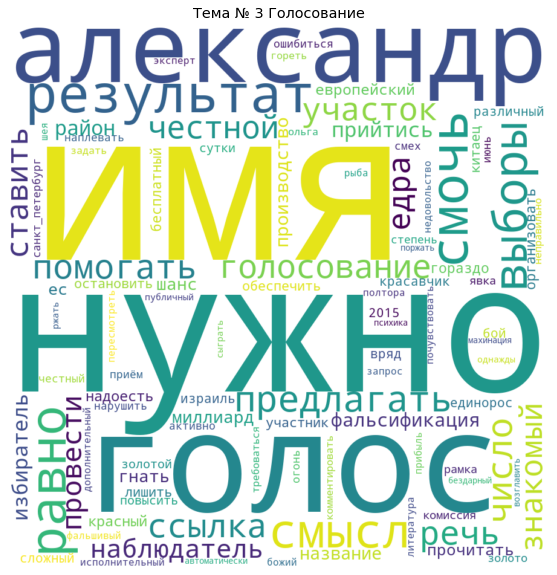

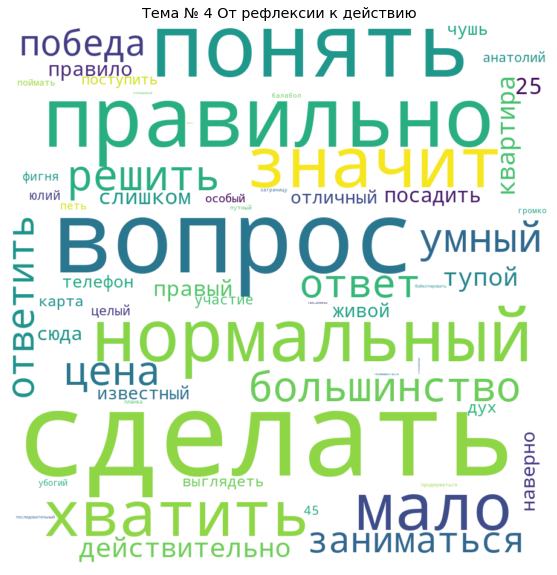

...

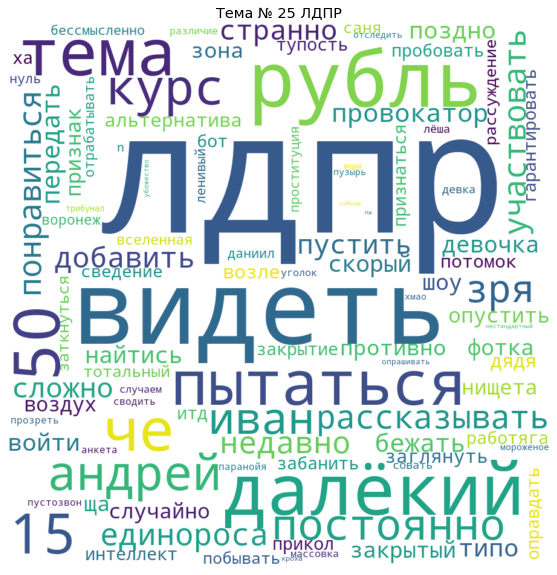

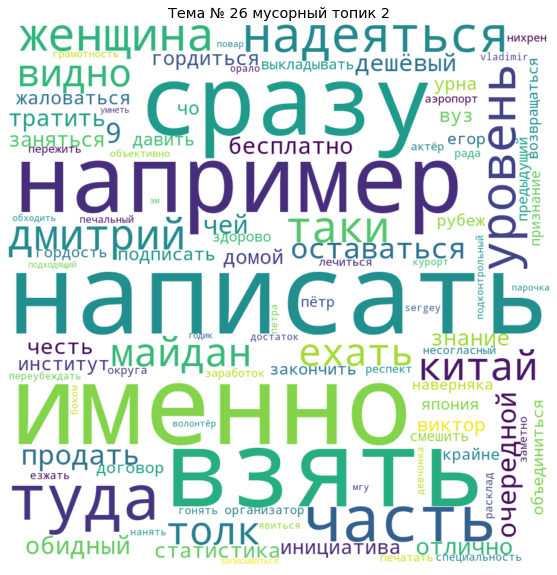

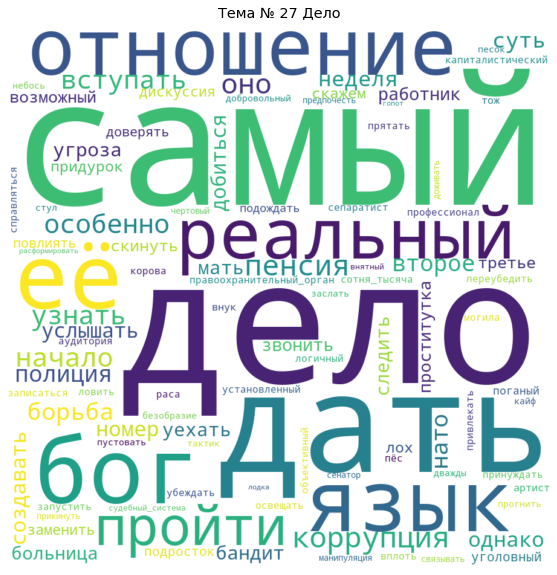

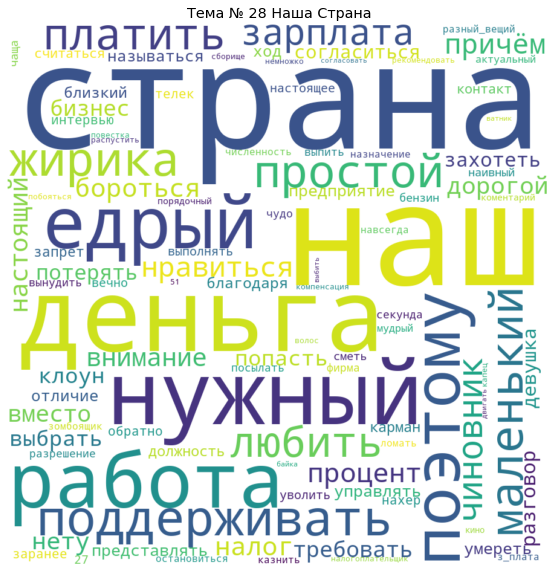

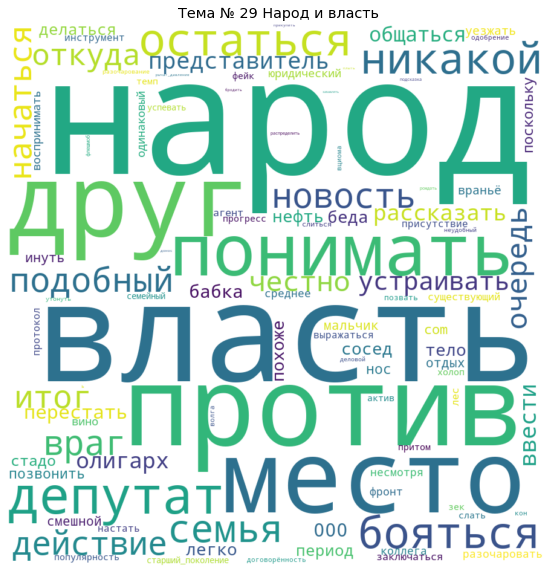

In [39]:
lda_topics = lda_model.show_topics(num_topics=top_num, num_words=100,formatted=False)
for i in range(top_num):
    plotWordCloud(topic_number=i, them_name=themes30[i])

**Visualization for 15 topics**

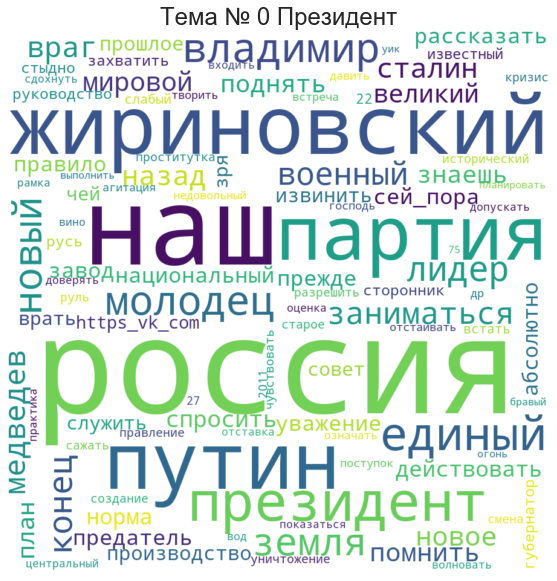

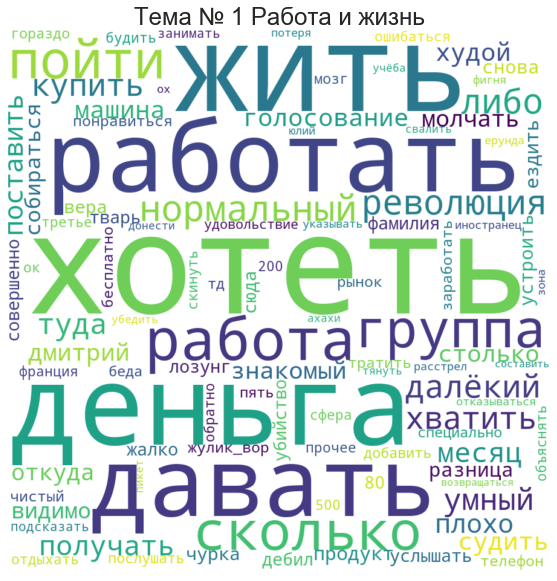

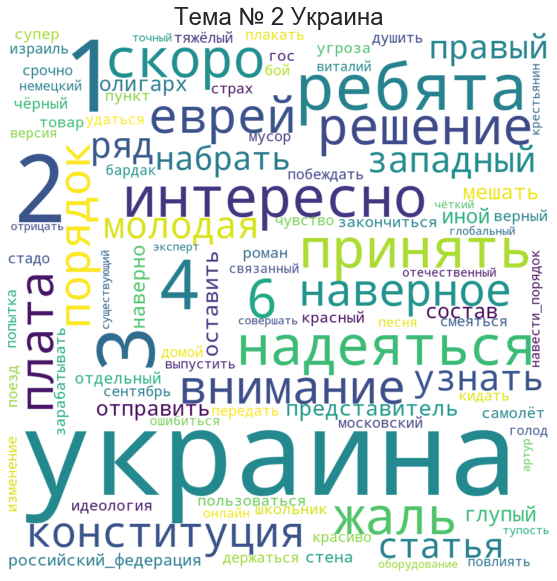

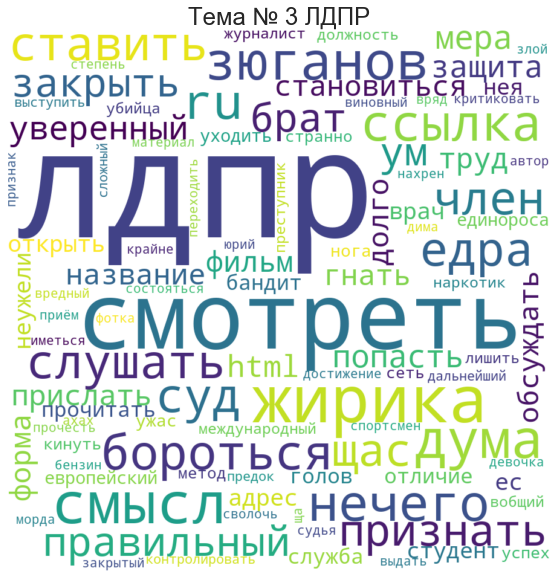

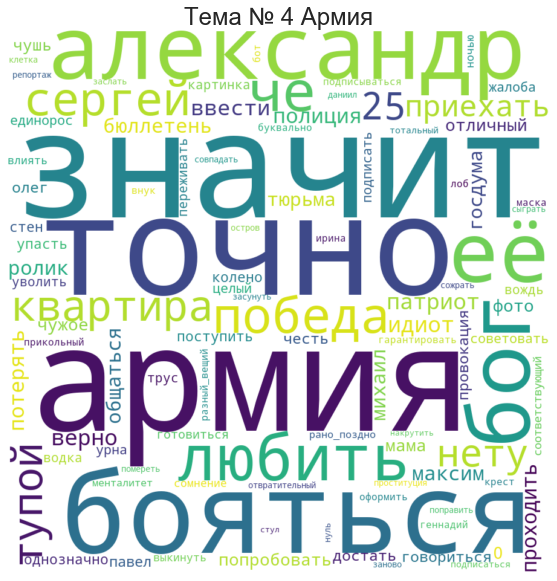

...

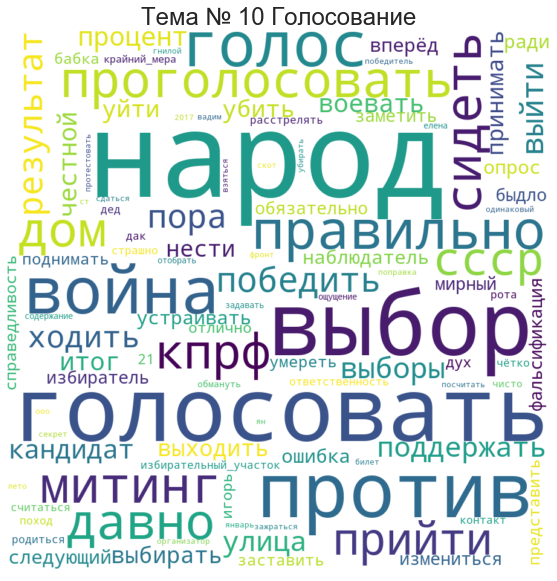

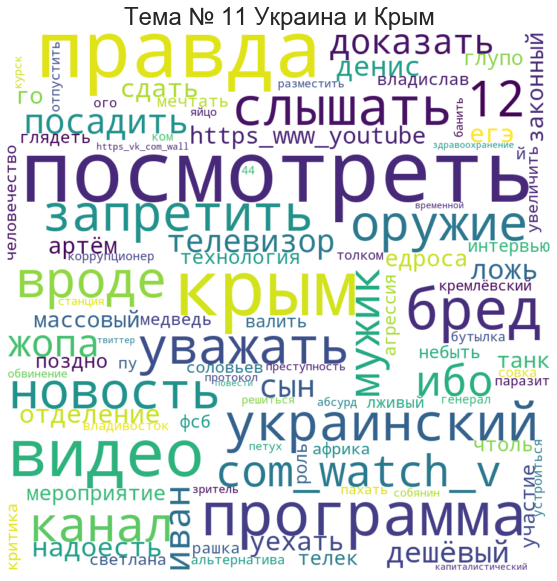

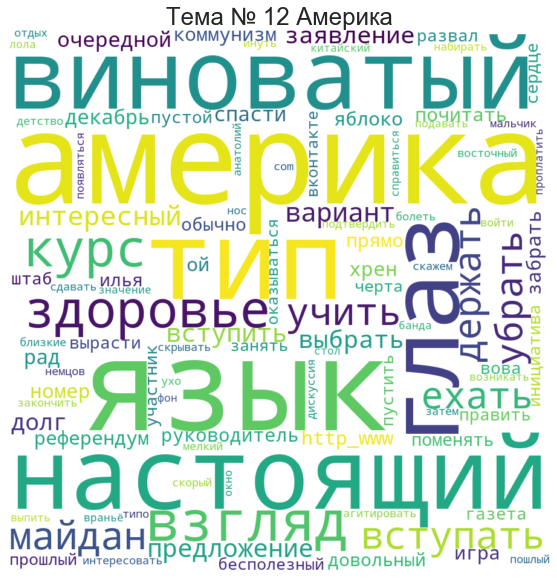

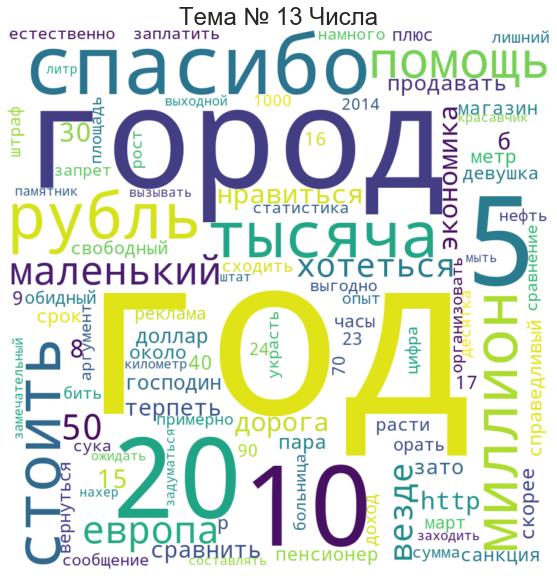

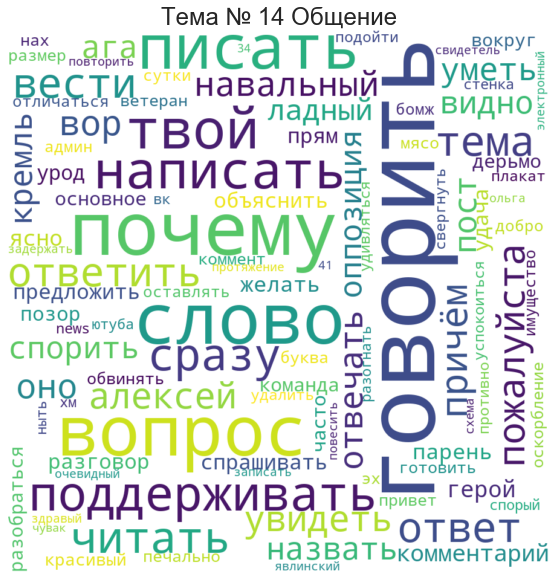

In [53]:
lda_topics = lda_model.show_topics(num_topics=top_num, num_words=100,formatted=False)
for i in range(top_num):
    plotWordCloud(topic_number=i, them_name=themes15[i])

## 4.2 Formation of topic profiles

In [40]:
def topicProfileGenre(model, party, dataset, corpus, genre=True):

    # Result Variable
    theme_results = [ ]

    # Number of Topics
    r = model.num_topics
    
    # Select from the table those lines that correspond to the current genre
    if genre:
        num = dataset[dataset.party == party].index.get_values() 
    else:
        num = dataset[dataset.ideology == party].index.get_values() 
    # Vector for thematic profile
    theme_profile = np.zeros(r)
    err = 0 
    print('Для партии \t{} корпус {} комментариев'.format(cur_party, len(num)))
    # Run through all fans of the current genre
    for i in num:
        try:
            # Сurrent topic profile
            cur_user_prof = model.get_document_topics(corpus[i])
            # Sort by topic number
            cur_user_prof = sorted(cur_user_prof, key=lambda w: w[0], reverse=True)      

            ind = [cup[0] for cup in cur_user_prof]     # делаем вектор с номерами тем
            prob = np.array([cup[1] for cup in cur_user_prof]) # делаем вектор с весами  
            theme_profile[ind] += prob        # Увеличиваем соответствующие веса
        except:
            err += 1 

    # Normalizing
    if (err>0):
        print('Доля битых профилей для {}:'.format(party), err/len(num))
    theme_profile = theme_profile / np.sum(theme_profile)
    theme_profile = list(zip(range(r),theme_profile))
    return theme_profile

In [54]:
if (prepare):    
    party_themes = { }
    for cur_party in tqdm_notebook(df.party.unique()):
        theme = topicProfileGenre(lda_model, cur_party, df, corpus)
        party_themes[cur_party] = theme
    
    # Save the dictionary with thematic profiles
    with open('party_{}_themes'.format(top_num), 'wb') as f:
        pickle.dump(party_themes, f)
else:
    # Read the dictionary with thematic profiles
    with open('party_{}_themes'.format(top_num), 'rb') as f:
        party_themes = pickle.load(f)


In [43]:
def profilePlot(theme_profile, party, themes):
    """
    Thematic profile for each party
    theme_profile:
        thematic profile, dict
    party: 
        party name
    themes dict:
        topic names
    """
    
    theme_profile = theme_profile[party]
    sorted_prof = sorted(theme_profile, key=lambda w: w[1], reverse=True)   
    
    # рисуем картинку
    sns.set(font_scale=2)
    plt.subplots(figsize=(30, 40))
    
    prof = np.array([pr[1] for pr in sorted_prof]).reshape(1,-1)
    them = [themes[pr[0]] for pr in sorted_prof]
    
    ax = plt.axes()    
    sns.heatmap(prof, ax = ax, square=True, annot=True, fmt=".2f", linewidths=0.1, 
                 cmap="YlGnBu", cbar=False, yticklabels='', xticklabels=them )
    ax.set_title('Тематический профиль для {}: \n'.format(party))
    plt.show()

**Visualization for 30 topics**

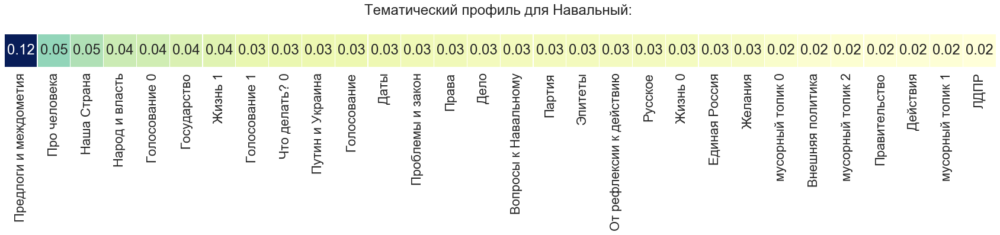

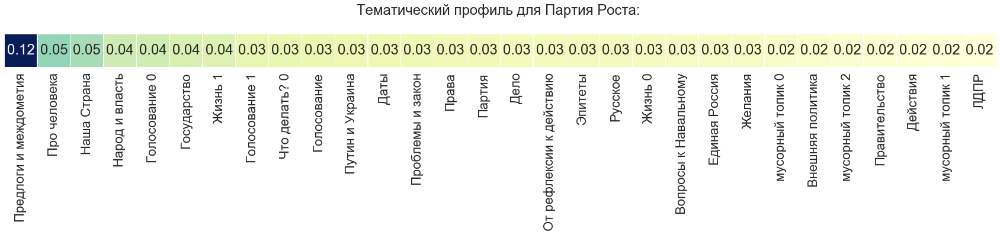

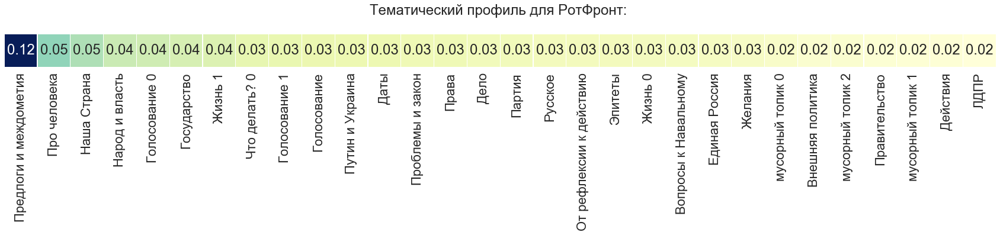

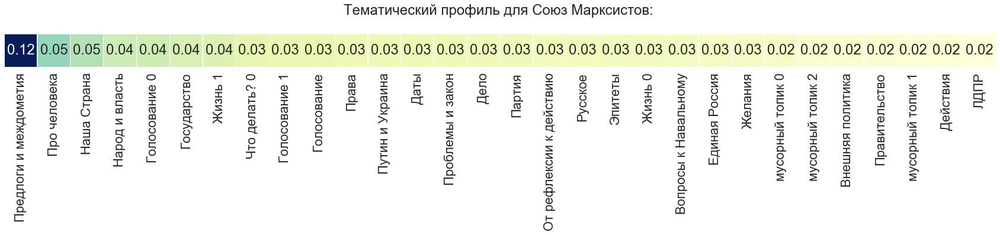

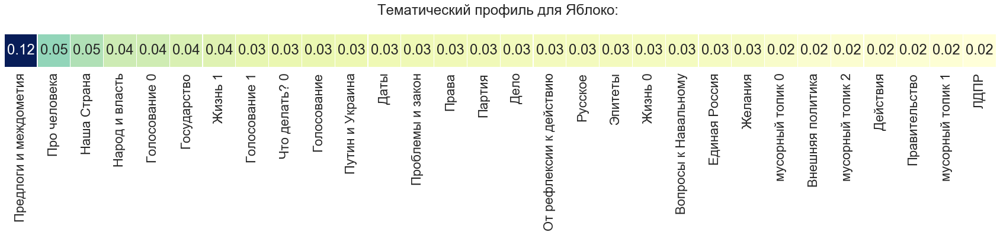

...

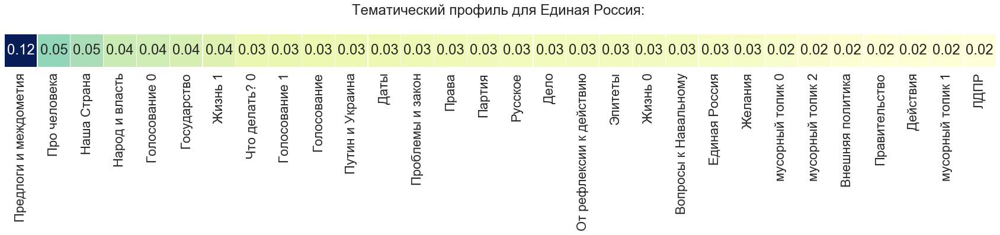

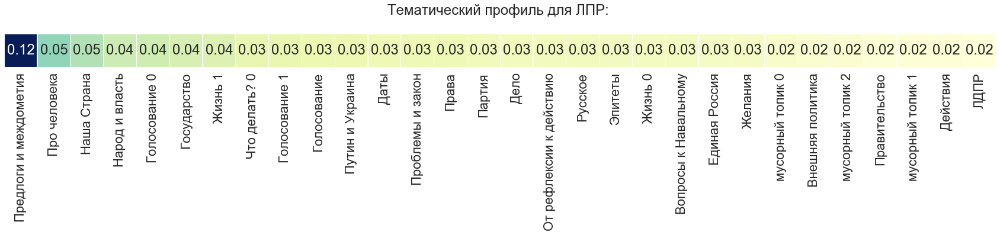

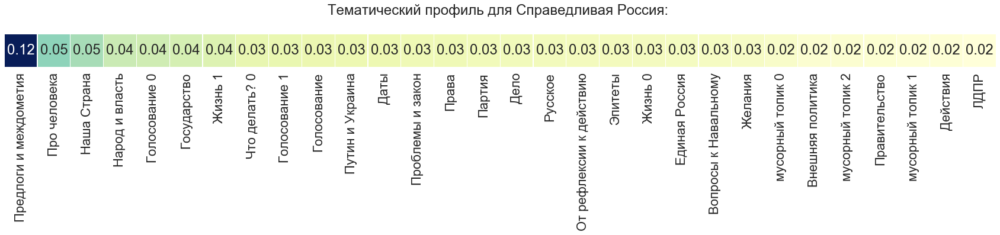

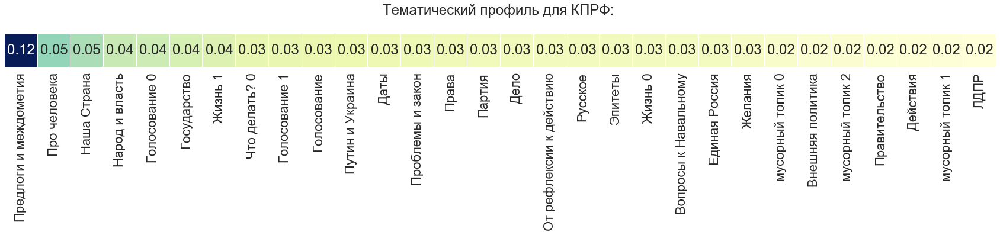

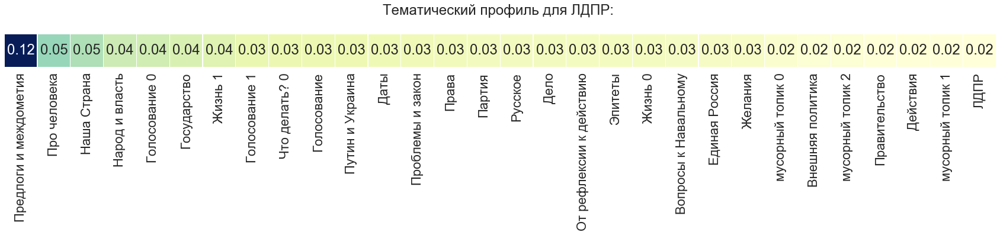

In [44]:
for cur_party in df.party.unique():
    profilePlot(party_themes, cur_party, themes=themes30)

**Visualization for 15 topics**

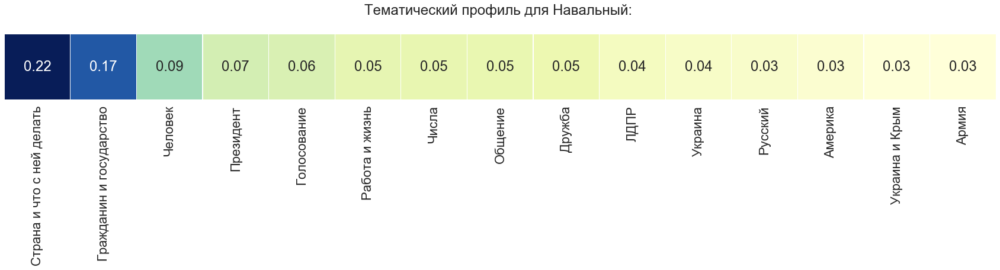

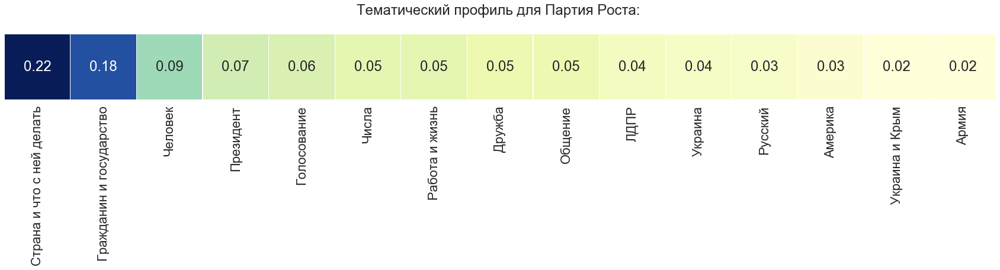

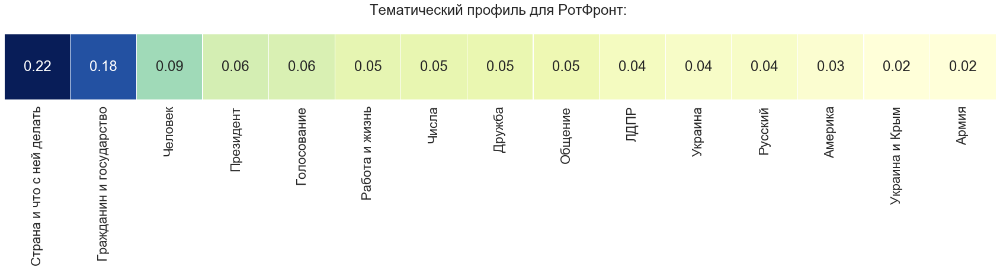

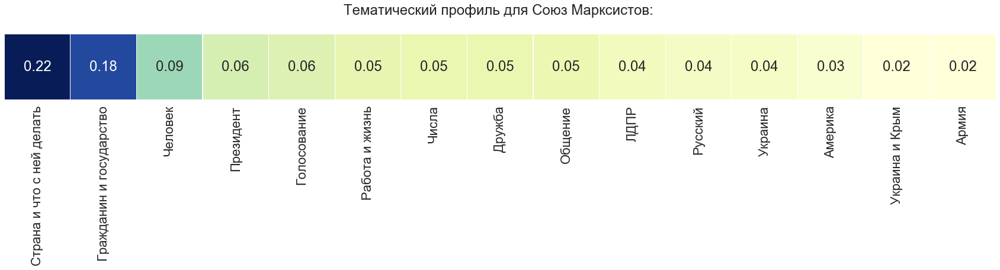

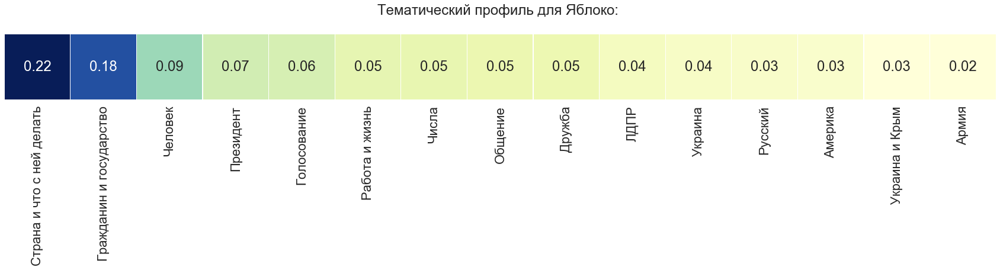

...

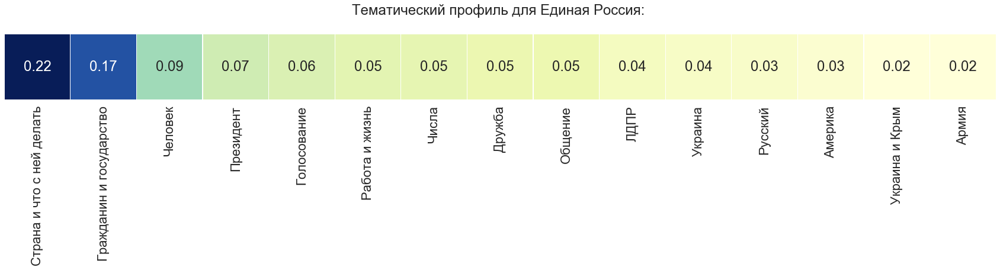

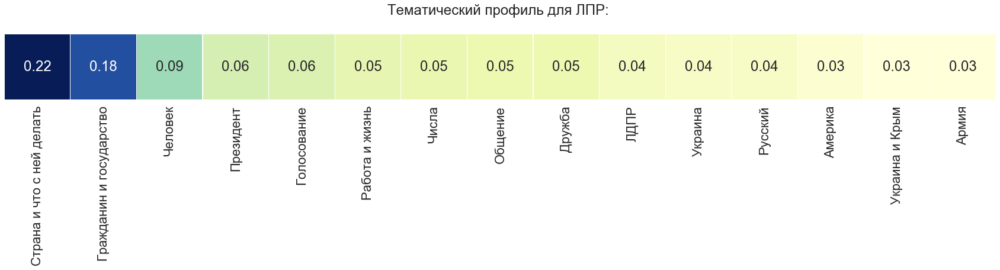

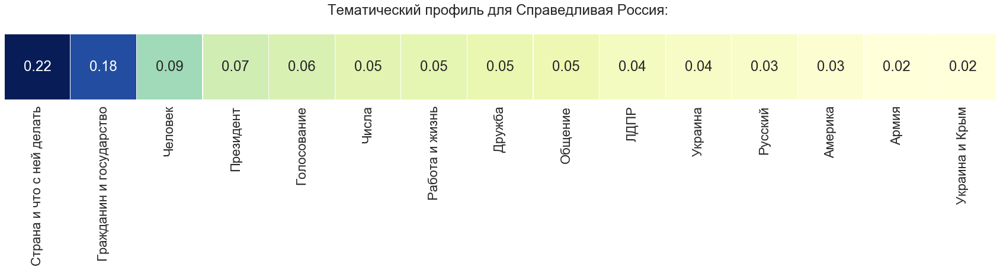

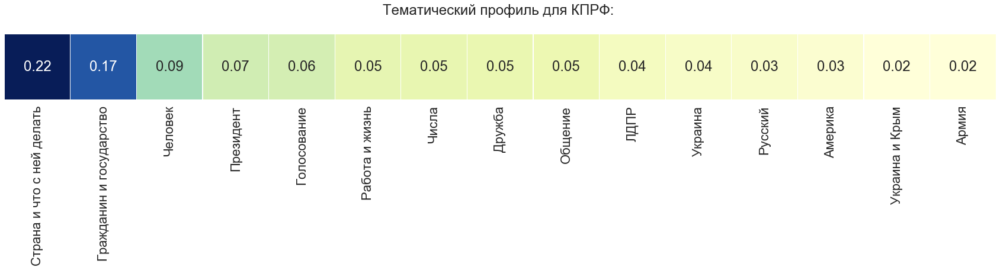

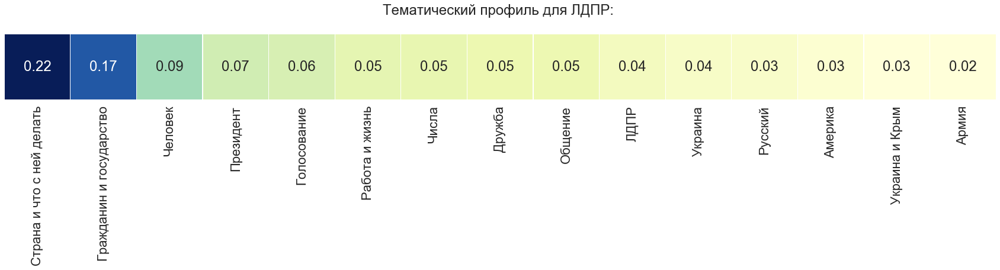

In [55]:
for cur_party in df.party.unique():
    profilePlot(party_themes, cur_party, themes=themes15)

## 4.3 Visualization of topic profiles

In [56]:
import umap
import chart_studio.plotly as py
import plotly.graph_objects as go

In [57]:
party_themes_clusters = {}
for k, v in party_themes.items():
    party_themes_clusters[k] = [prob[1] for prob in v]
    
party_themes_clusters = pd.DataFrame(party_themes_clusters).T

In [58]:
umap_model = umap.UMAP(
                        n_neighbors = 20         ,#15,
                        n_components= 2          ,#2,
                        metric      = 'cosine'   ,#'euclidean',
                        min_dist    = 0.01       ,#0.1,
                        random_state= 10          #10,
                        )


umap_features = umap_model.fit_transform(party_themes_clusters)

**Visualization for 30 topics**

In [48]:
# Create a trace
trace = go.Scatter(
    x = umap_features[:, 0],
    y = umap_features[:, 1],
    mode = 'markers+text',
    text = party_themes_clusters.index,
    textposition='top center'
)

data = [trace]

layout = go.Layout(
    autosize=False,
    width=800,
    height=800
)

fig = go.Figure(data=data, layout=layout)
fig.show(filename='size-margins')

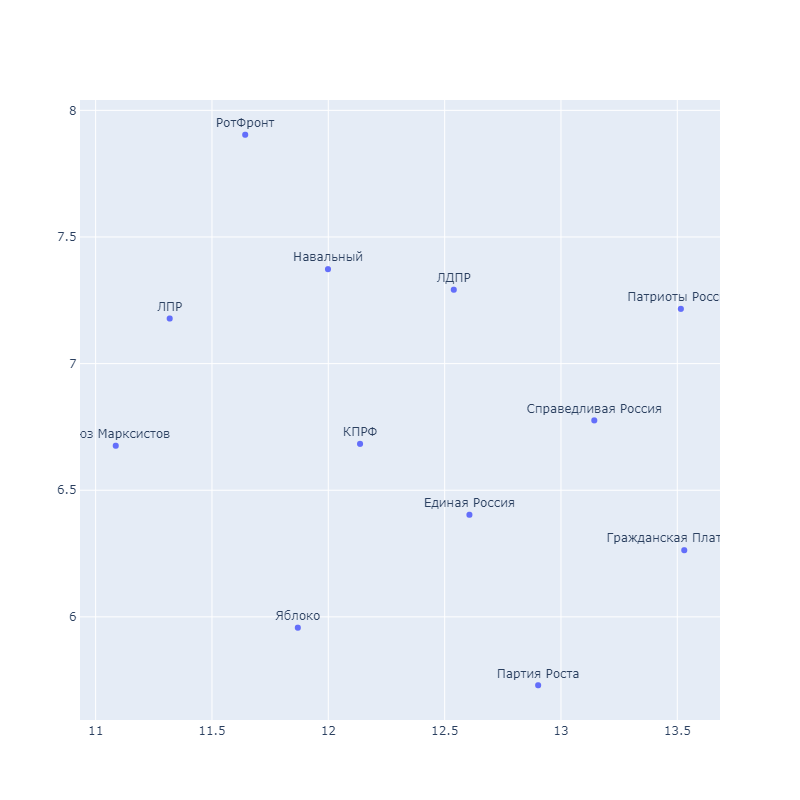

**Visualization for 15 topics**

In [59]:
# Create a trace
trace = go.Scatter(
    x = umap_features[:, 0],
    y = umap_features[:, 1],
    mode = 'markers+text',
    text = party_themes_clusters.index,
    textposition='top center'
)

data = [trace]

layout = go.Layout(
    autosize=False,
    width=800,
    height=800
)

fig = go.Figure(data=data, layout=layout)
fig.show(filename='size-margins')

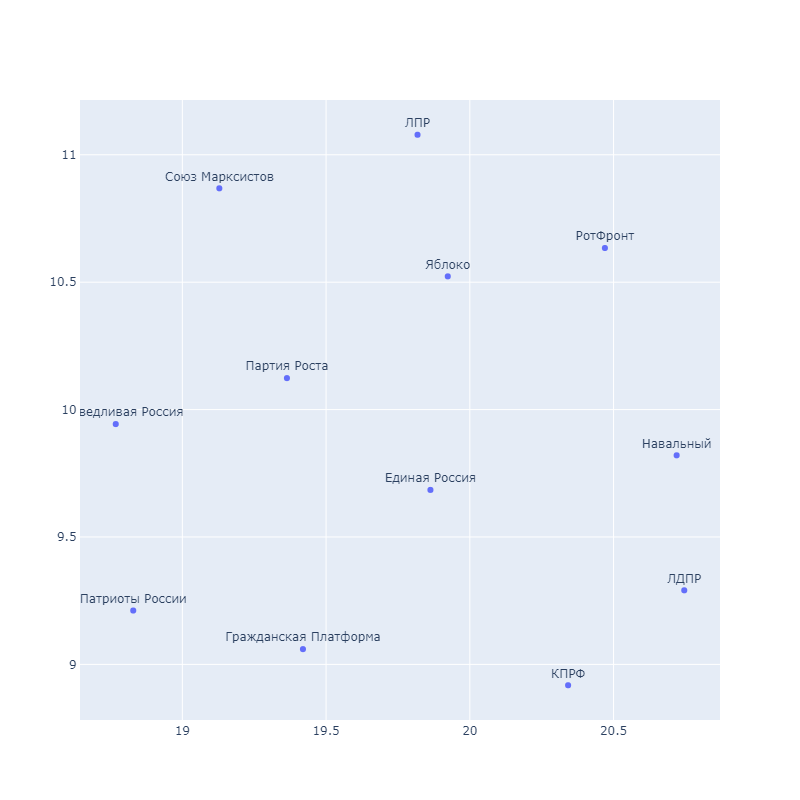

## 4.4 Cosine Similarity of topic profiles

In [577]:
from sklearn.metrics.pairwise import cosine_similarity

**Visualization for 30 topics**

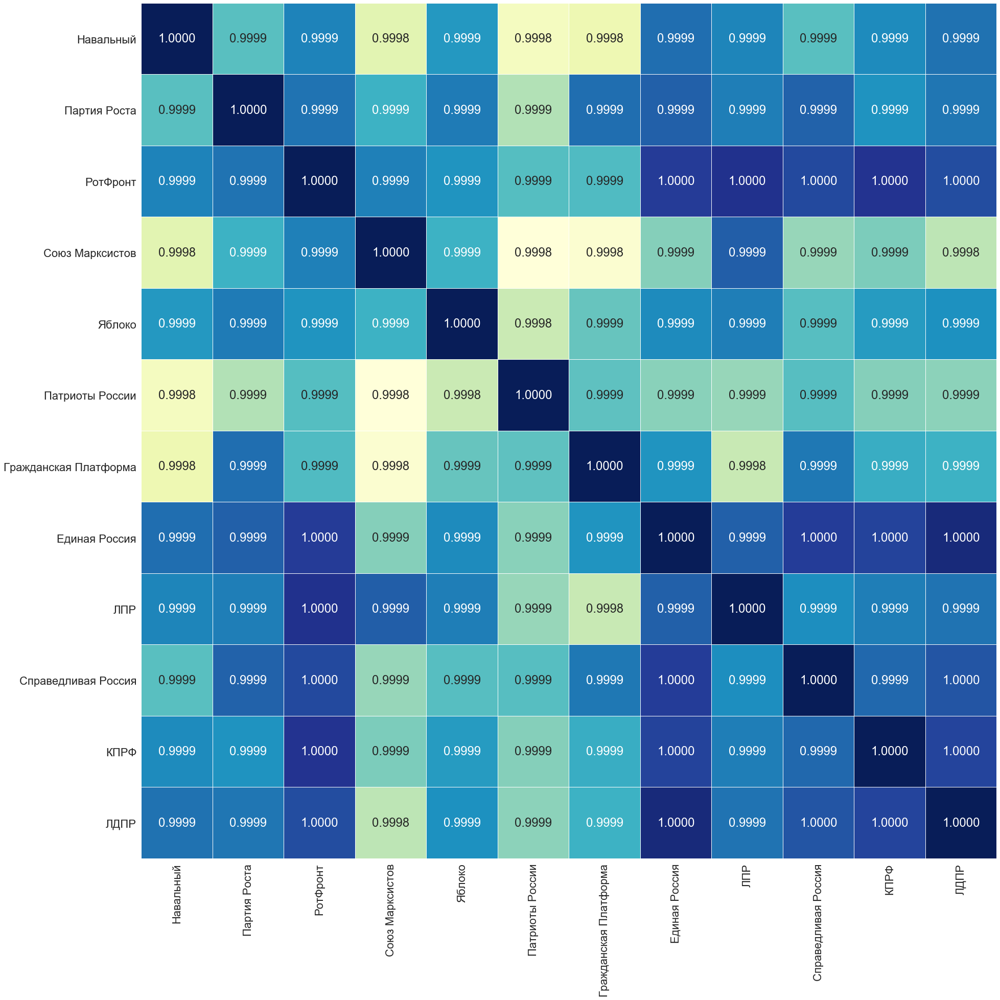

In [503]:
thems_vec_array = np.array([[j[1] for j in party_themes[i]] for i in party_themes])
cosin_matrix = cosine_similarity(thems_vec_array)
party_name = [i for i in party_themes]

sns.set(font_scale=2)
plt.subplots(figsize=(30, 40))

ax = plt.axes()    
sns.heatmap(cosin_matrix, ax = ax, square=True, annot=True, fmt=".4f", linewidths=0.1, 
             cmap="YlGnBu", cbar=False, yticklabels=party_name, xticklabels= party_name)
ax.set_title('')
plt.show()

**Visualization for 15 topics**

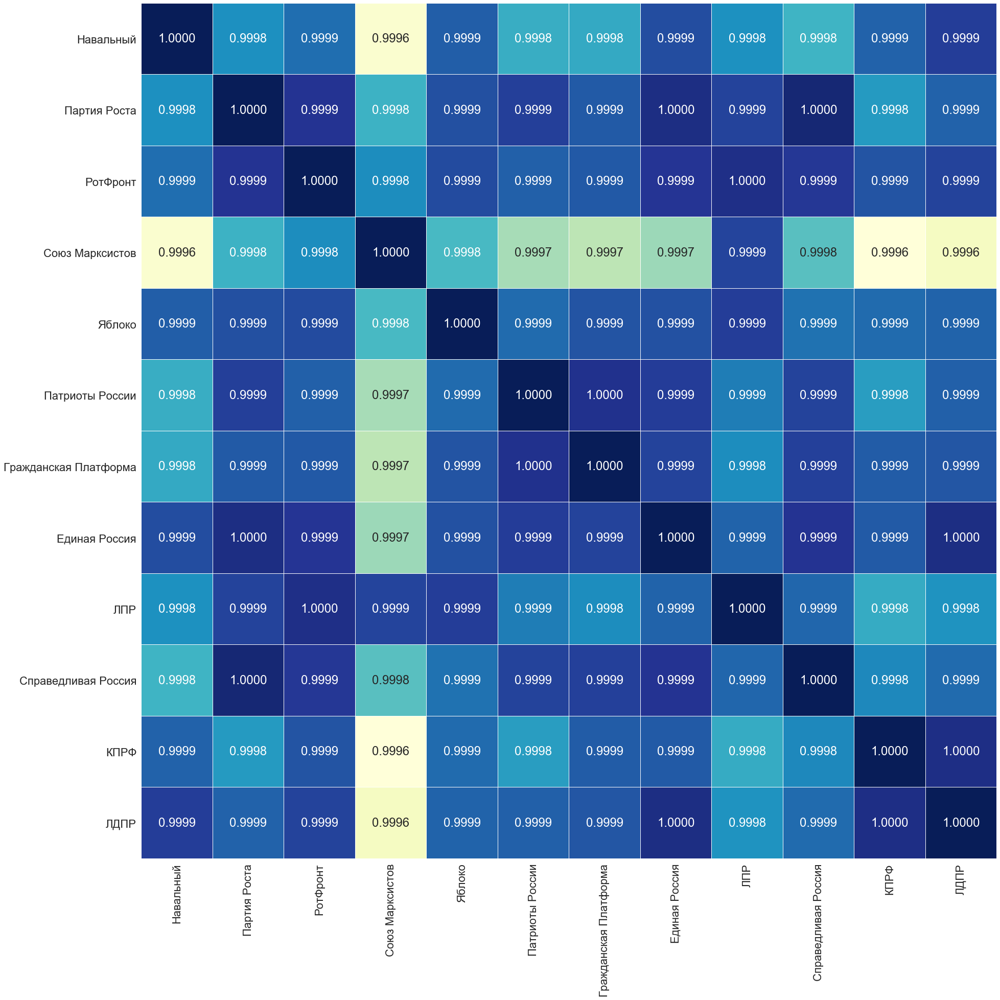

In [578]:
thems_vec_array = np.array([[j[1] for j in party_themes[i]] for i in party_themes])
cosin_matrix = cosine_similarity(thems_vec_array)
party_name = [i for i in party_themes]

sns.set(font_scale=2)
plt.subplots(figsize=(30, 40))

ax = plt.axes()    
sns.heatmap(cosin_matrix, ax = ax, square=True, annot=True, fmt=".4f", linewidths=0.1, 
             cmap="YlGnBu", cbar=False, yticklabels=party_name, xticklabels= party_name)
ax.set_title('')
plt.show()

# 5. Conclusion

1.	Поскольку в комментариях люди обсуждают всё, а не только политику, темы не так хорошо интерпретируются.  
  
2.	Судя по тематическим профилям, люди в группах обсуждают примерно одно и то же, что не удивительно.  
  
3.	В дальнейшем было бы интересно составить тематические профили не по партиям, а по времени. Или сделать временные срезы  и посмотреть, как изменятся тематические профили партий.  
  
4.	Примечательно, что при разделении на 15 тем максимально не похожа на остальные партия Союз Марксистов. При этом, электорат Союза Марксистов максимально схож по риторике с электоратом Либертарианской Партии России.  
